## Breast Cancer Proteomic Network Modelling

### Mathematical Modelling in Industry - Math Research, MSc

Setting up the env - Importing all needed libraries and configs for the notebook.

In [641]:
import numpy as np 
import pandas as pd
import seaborn as sns
import statistics as stats
import re
import matplotlib.pyplot as plt
import networkx as nx
import os
import warnings

In [642]:
plt.switch_backend('agg')
warnings.filterwarnings('ignore')

In [643]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [644]:
from sklearn.impute import SimpleImputer

### Data import

* **in_proteomes_77**: 77 breast cancer samples generated by the Clinical Proteomic Tumor Analysis Consortium (NCI/NIH). It contains expression values for ~12.000 proteins for each sample, with missing values present when a given protein could not be quantified in a given sample.
* **in_clinical_data**: data about the cancer classification of a given sample using different methods.
* **in_PAM50**: Contains the list of genes and proteins used by the PAM50 classification system

In [645]:
os.chdir("/Users/xavigalarza/workspace/BreastCancerProteomics/data/")

In [646]:
# Reading input data as pandas.
in_proteomes_77 = pd.read_csv('./77_cancer_proteomes_CPTAC_itraq.csv')
in_clinical_data = pd.read_csv('./clinical_data_breast_cancer.csv')
in_PAM50 = pd.read_csv('./PAM50_proteins.csv')

### Nature and size of the source inputs. First pre-processing of the data. Normalization stage.

In [647]:
in_clinical_data = in_clinical_data.set_index(['Complete TCGA ID'])
in_clinical_data.head()

,Gender,Age at Initial Pathologic Diagnosis,ER Status,PR Status,HER2 Final Status,Tumor,Tumor--T1 Coded,Node,Node-Coded,Metastasis,...,PAM50 mRNA,SigClust Unsupervised mRNA,SigClust Intrinsic mRNA,miRNA Clusters,methylation Clusters,RPPA Clusters,CN Clusters,Integrated Clusters (with PAM50),Integrated Clusters (no exp),Integrated Clusters (unsup exp)
Complete TCGA ID,,,,,,,,,,,,,,,,,,,,,
TCGA-A2-A0T2,FEMALE,66,Negative,Negative,Negative,T3,T_Other,N3,Positive,M1,...,Basal-like,0,-13,3,5,Basal,3,2,2,2
TCGA-A2-A0CM,FEMALE,40,Negative,Negative,Negative,T2,T_Other,N0,Negative,M0,...,Basal-like,-12,-13,4,4,Basal,4,2,1,1
TCGA-BH-A18V,FEMALE,48,Negative,Negative,Negative,T2,T_Other,N1,Positive,M0,...,Basal-like,-12,-13,5,5,Basal,1,2,2,2
TCGA-BH-A18Q,FEMALE,56,Negative,Negative,Negative,T2,T_Other,N1,Positive,M0,...,Basal-like,-12,-13,5,5,Basal,1,2,2,2
TCGA-BH-A0E0,FEMALE,38,Negative,Negative,Negative,T3,T_Other,N3,Positive,M0,...,Basal-like,0,-13,5,5,Basal,1,2,2,2


In [648]:
in_proteomes_77.head()

,RefSeq_accession_number,gene_symbol,gene_name,AO-A12D.01TCGA,C8-A131.01TCGA,AO-A12B.01TCGA,BH-A18Q.02TCGA,C8-A130.02TCGA,C8-A138.03TCGA,E2-A154.03TCGA,...,AO-A12B.34TCGA,A2-A0SW.35TCGA,AO-A0JL.35TCGA,BH-A0BV.35TCGA,A2-A0YM.36TCGA,BH-A0C7.36TCGA,A2-A0SX.36TCGA,263d3f-I.CPTAC,blcdb9-I.CPTAC,c4155b-C.CPTAC
0,NP_958782,PLEC,plectin isoform 1,1.096131,2.609943,-0.659828,0.195341,-0.494060,2.765081,0.862659,...,-0.963904,-0.487772,-0.10668,-0.065838,0.655850,-0.552212,-0.398560,0.598585,-0.191285,0.566975
1,NP_958785,NaN,plectin isoform 1g,1.111370,2.650422,-0.648742,0.215413,-0.503899,2.779709,0.870186,...,-0.938210,-0.487772,-0.10668,-0.055893,0.658143,-0.547749,-0.392601,0.606697,-0.183918,0.578702
2,NP_958786,PLEC,plectin isoform 1a,1.111370,2.650422,-0.654285,0.215413,-0.500619,2.779709,0.870186,...,-0.943919,-0.487772,-0.10668,-0.065838,0.655850,-0.552212,-0.392601,0.603993,-0.186022,0.576747
3,NP_000436,NaN,plectin isoform 1c,1.107561,2.646374,-0.632113,0.205377,-0.510459,2.797995,0.866423,...,-0.935355,-0.487772,-0.10668,-0.055893,0.655850,-0.552212,-0.392601,0.603993,-0.186022,0.576747
4,NP_958781,NaN,plectin isoform 1e,1.115180,2.646374,-0.640428,0.215413,-0.503899,2.787023,0.870186,...,-0.935355,-0.503853,-0.10668,-0.062523,0.651264,-0.556675,-0.395581,0.603993,-0.167079,0.576747


__RefSeq_accession_number__ is a unique Protein ID, whereas all the *TCGA columns are unique IDs of Patients. We'll need to transpose the Dataframe as we will be working following a Patient based approach with Proteins as attributes. The columns __gene_symbol__ and __gene_name__ are not providing any useful information at this stage - we will get rid of these. 

In [649]:
in_PAM50.head()

,GeneSymbol,RefSeqProteinID,Species,Gene Name
0,MIA,NP_006524,Homo sapiens,melanoma inhibitory activity
1,FGFR4,NP_002002,Homo sapiens,fibroblast growth factor receptor 4
2,FGFR4,NP_998812,Homo sapiens,fibroblast growth factor receptor 4
3,FGFR4,NP_075252,Homo sapiens,fibroblast growth factor receptor 4
4,GPR160,NP_055188,Homo sapiens,G protein-coupled receptor 160


In [650]:
in_proteomes_77.drop(['gene_symbol','gene_name'],axis=1,inplace=True)

# Naming normalization: will rename all the TCGAs codes as are found in clinical_data.
in_proteomes_77.rename(columns=lambda x: "TCGA-%s" % (re.split('[_|-|.]',x)[0]) if bool(re.search("TCGA",x)) is True else x, inplace=True)
#in_proteomes_77.rename(columns={'RefSeq_accession_number':'RefSeqProteinID'})

# Transposing the DF
proteomes_base_df = in_proteomes_77.transpose()
proteomes_base_df = proteomes_base_df.rename(columns=proteomes_base_df.iloc[0]).drop(proteomes_base_df.index[0])

In [651]:
proteomes_base_df.head()

,NP_958782,NP_958785,NP_958786,NP_000436,NP_958781,NP_958780,NP_958783,NP_958784,NP_112598,NP_001611,...,NP_001193600,NP_061134,NP_932347,NP_003593,NP_997203,NP_001191293,NP_775791,NP_004065,NP_068752,NP_219494
TCGA-AO-A12D,1.09613,1.11137,1.11137,1.10756,1.11518,1.10756,1.11137,1.11137,-1.51739,0.482754,...,NaN,NaN,NaN,-0.340163,NaN,NaN,NaN,NaN,-0.633517,12.6665
TCGA-C8-A131,2.60994,2.65042,2.65042,2.64637,2.64637,2.64637,2.65042,2.65042,3.90931,-1.04529,...,NaN,NaN,NaN,3.4519,NaN,NaN,NaN,NaN,4.84033,0.140736
TCGA-AO-A12B,-0.659828,-0.648742,-0.654285,-0.632113,-0.640428,-0.654285,-0.648742,-0.648742,-0.618256,1.222,...,NaN,NaN,NaN,-1.71853,NaN,NaN,NaN,NaN,-1.96519,-2.85484
TCGA-BH-A18Q,0.195341,0.215413,0.215413,0.205377,0.215413,0.215413,0.215413,0.215413,-1.03576,-0.517226,...,0.0481439,NaN,-0.881872,2.52707,-8.11124,-16.0298,-2.04607,-1.77843,NaN,-3.06975
TCGA-C8-A130,-0.49406,-0.503899,-0.500619,-0.510459,-0.503899,-0.503899,-0.500619,-0.500619,-1.84537,-0.405503,...,1.45746,NaN,1.71001,0.296389,-1.75353,1.72969,-0.425182,-0.149673,NaN,-0.0479974


In [652]:
in_proteomes_77.shape

(12553, 84)

In [653]:
proteomes_base_df.shape

(83, 12553)

In [654]:
# Master df will contain all joined data from the main two csv: 77_proteomes and clinical data.
master_df = proteomes_base_df.join(in_clinical_data, how='inner')

In [655]:
master_df.head()

,NP_958782,NP_958785,NP_958786,NP_000436,NP_958781,NP_958780,NP_958783,NP_958784,NP_112598,NP_001611,...,PAM50 mRNA,SigClust Unsupervised mRNA,SigClust Intrinsic mRNA,miRNA Clusters,methylation Clusters,RPPA Clusters,CN Clusters,Integrated Clusters (with PAM50),Integrated Clusters (no exp),Integrated Clusters (unsup exp)
TCGA-A2-A0CM,0.683404,0.694424,0.698098,0.687077,0.687077,0.698098,0.698098,0.698098,-2.65215,-0.984373,...,Basal-like,-12,-13,4,4,Basal,4,2,1,1
TCGA-A2-A0D2,0.107491,0.104164,0.107491,0.0975117,0.104164,0.104164,0.104164,0.104164,-0.880454,-1.51247,...,Basal-like,-12,-13,4,5,Basal,3,2,2,2
TCGA-A2-A0EQ,-0.91267,-0.927979,-0.927979,-0.931806,-0.927979,-0.927979,-0.927979,-0.927979,-3.07115,-2.27894,...,HER2-enriched,-5,-2,5,4,Basal,4,4,1,1
TCGA-A2-A0EV,0.452986,0.47259,0.47259,0.458587,0.47259,0.47259,0.47259,0.47259,-0.742871,1.81128,...,Luminal A,-4,0,4,2,ReacI,3,3,3,4
TCGA-A2-A0EX,1.18511,1.19261,1.18886,1.18511,1.20012,1.18886,1.18886,1.19261,1.04629,2.13808,...,Luminal A,-7,-5,4,4,ReacI,4,3,1,4


In [656]:
print("We have {} rows not being found within our base proteomes DF. Making, hence, a total of {} complete - with clinical and proteome data- records ".format(proteomes_base_df.size - master_df.size, master_df.size))

We have 35339 rows not being found within our base proteomes DF. Making, hence, a total of 1006560 complete - with clinical and proteome data- records 


In [657]:
proteomes_df = master_df.loc[:,[x for x in master_df.columns if bool(re.search("NP_|XP_",x)) == True]]

In [658]:
proteomes_df.isnull().sum().sum()

104030

In [680]:
# replacing all Null values by the median computed by patient (not by proteome).
imp = SimpleImputer(missing_values=np.nan, strategy='median')
imp = imp.fit(proteomes_df)

clean_working_df = imp.transform(proteomes_df)

In [681]:
# Analysis of type vs size distribution
test = in_clinical_data.groupby(["PAM50 mRNA","Tumor"]).size()
test.head(30)

PAM50 mRNA     Tumor
Basal-like     T1        3
               T2       18
               T3        3
               T4        1
HER2-enriched  T1        3
               T2       11
               T3        4
Luminal A      T1        6
               T2       15
               T3        7
               T4        1
Luminal B      T1        3
               T2       21
               T3        5
               T4        4
dtype: int64

In [667]:
# Preparing the DF for the unsupervised alg: filtering out all the fields not numeric and translating the target field to numeric.
unsupervised_df = master_df.loc[:,[x for x in master_df.columns if bool(re.search("NP_|XP_|PAM50 ",x)) == True]]
unsupervised_df = unsupervised_df.replace(regex={'Basal-like': 1, 'HER2-enriched': 2, 'Luminal A': 3, 'Luminal B': 4})

In [668]:
# Splitting between training and target sets
X = unsupervised_df.drop('PAM50 mRNA', axis=1)
y = unsupervised_df['PAM50 mRNA']

In [682]:
X.isnull().sum()

NP_958782        0
NP_958785        0
NP_958786        0
NP_000436        0
NP_958781        0
                ..
NP_001191293    34
NP_775791       58
NP_004065       57
NP_068752       55
NP_219494       54
Length: 12546, dtype: int64

In [683]:
# Replacing Null values
imp = SimpleImputer(missing_values=np.nan, strategy='median')
imp = imp.fit(X)

unsupervised_df = imp.transform(X)

In [693]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(unsupervised_df, y, test_size = 0.20)

### Main custom functions to reduce redunancy of code

In [694]:
def getStats(y_test, y_pred):
    # outputs the confusion matrix and a heatmap
    
    %matplotlib inline
    import seaborn as sns
    from sklearn.metrics import classification_report, confusion_matrix
    
    cm = confusion_matrix(y_test, y_pred)
    
    print(classification_report(y_test, y_pred))
    sns.heatmap(cm, annot=True, cmap="OrRd")

In [695]:
def applyClassifier(clf, param_grid, x_train, y_train, x_test):
    # Applies an estimator and searches for the best params given an input param grid.
    from sklearn.model_selection import GridSearchCV
    
    g_search = GridSearchCV(clf, param_grid, cv=5)
    g_search.fit(x_train, y_train)
    
    return g_search.predict(x_test), g_search.best_params_

### SVC

In [696]:
from sklearn.svm import SVC
svc = SVC()

param_grid = {'kernel': ('linear', 'rbf', 'sigmoid', 'poly'), 
              'C': [1, 10, 100, 1000], 
              'degree': [3,5,8,10] }

y_pred, best_params = applyClassifier(svc, param_grid, X_train, y_train, X_test)

In [697]:
print(best_params)

{'C': 1, 'degree': 3, 'kernel': 'linear'}


              precision    recall  f1-score   support

           1       0.88      1.00      0.93         7
           2       0.00      0.00      0.00         2
           3       1.00      0.67      0.80         3
           4       0.50      0.50      0.50         4

    accuracy                           0.69        16
   macro avg       0.59      0.54      0.56        16
weighted avg       0.70      0.69      0.68        16



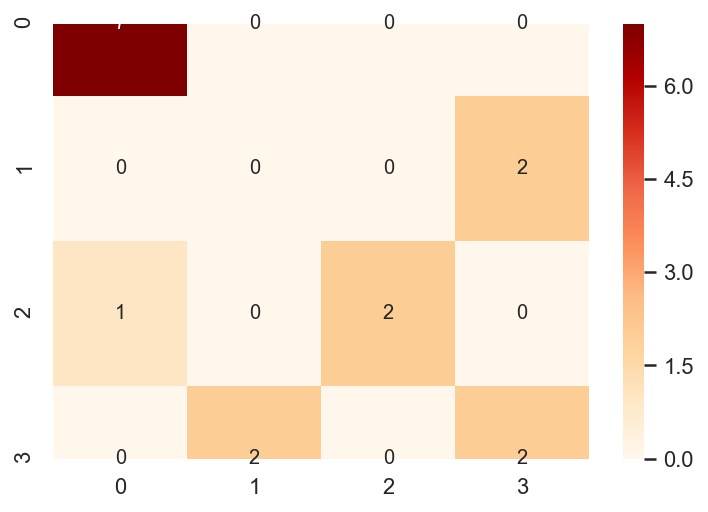

In [698]:
getStats(y_test, y_pred)

### KNN

In [699]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier()

param_grid = {'n_neighbors': np.arange(1, 25), 'weights':['uniform','distance']}

y_pred, best_params = applyClassifier(knn, param_grid, X_train, y_train, X_test)

In [700]:
print(best_params)

{'n_neighbors': 8, 'weights': 'uniform'}


              precision    recall  f1-score   support

           1       0.86      0.86      0.86         7
           2       0.00      0.00      0.00         2
           3       0.50      0.67      0.57         3
           4       0.80      1.00      0.89         4

    accuracy                           0.75        16
   macro avg       0.54      0.63      0.58        16
weighted avg       0.67      0.75      0.70        16



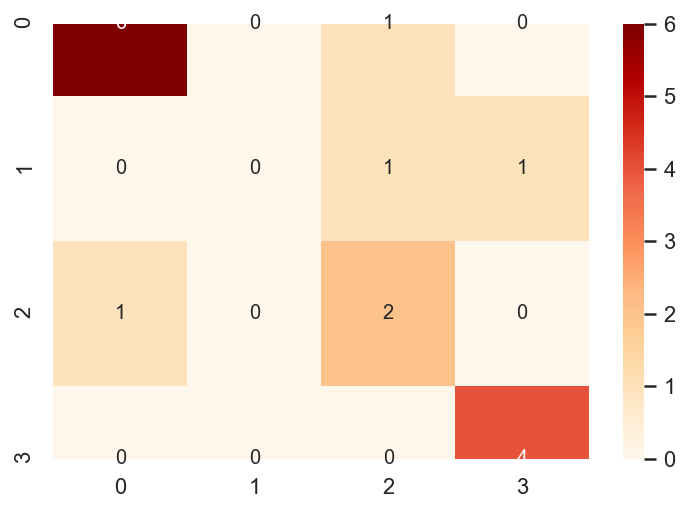

In [701]:
getStats(y_test, y_pred)

## Graph Representation.

### Graph Modelling. Pre-processing and Data Cleaning.

In the first place, we should first make sure we do not process more information than needed as could be computationally very expensive and also could provide more noise that insight.


In [573]:
# Reading input data as pandas.
in_proteomes_77 = pd.read_csv('./77_cancer_proteomes_CPTAC_itraq.csv')
in_clinical_data = pd.read_csv('./clinical_data_breast_cancer.csv')
in_PAM50 = pd.read_csv('./PAM50_proteins.csv')

We will clean the proteomes_77 dataset just to keep the protein profiling and the patient TCGA code.
Also, we just want all the data from the records we 

In [574]:
in_proteomes_77.drop(['gene_symbol','gene_name'],axis=1,inplace=True)
in_proteomes_77.set_index(['RefSeq_accession_number'])

# Naming normalization to match same syntax as clinical data
in_proteomes_77.rename(columns=lambda x: "TCGA-%s" % (re.split('[_|-|.]',x)[0]) if bool(re.search("TCGA",x)) is True else x, inplace=True)

# Getting rid of the data in proteomes_77 that are not PAM50 by inner join.
in_join = in_proteomes_77.join(in_PAM50,how='inner')
in_join.drop(['GeneSymbol','Species','Gene Name','RefSeqProteinID'], axis=1, inplace=True)

# Transposing the DF
proteomes_base_df = in_join.transpose()
proteomes_base_df = proteomes_base_df.rename(columns=proteomes_base_df.iloc[0]).drop(proteomes_base_df.index[0])

In [575]:
proteomes_base_df.head()

,NP_958782,NP_958785,NP_958786,NP_000436,NP_958781,NP_958780,NP_958783,NP_958784,NP_112598,NP_001611,...,NP_612482,NP_006176,NP_006258,NP_055185,NP_001137485,NP_005045,NP_872394,NP_001019628,NP_872634,NP_005029
TCGA-AO-A12D,1.09613,1.11137,1.11137,1.10756,1.11518,1.10756,1.11137,1.11137,-1.51739,0.482754,...,0.901831,-0.808768,0.254166,0.802777,-0.0696671,0.334172,-0.0125201,0.124633,0.0865347,1.01994
TCGA-C8-A131,2.60994,2.65042,2.65042,2.64637,2.64637,2.64637,2.65042,2.65042,3.90931,-1.04529,...,0.302651,-1.12625,0.403848,1.16485,0.310747,0.270268,0.294555,0.432183,0.0476343,0.66696
TCGA-AO-A12B,-0.659828,-0.648742,-0.654285,-0.632113,-0.640428,-0.654285,-0.648742,-0.648742,-0.618256,1.222,...,1.02246,0.947627,0.0358119,-0.147105,0.0358119,-0.0639612,0.0302689,0.0884699,1.20815,-0.670914
TCGA-BH-A18Q,0.195341,0.215413,0.215413,0.205377,0.215413,0.215413,0.215413,0.215413,-1.03576,-0.517226,...,0.0782523,-1.19634,0.23214,0.931325,0.268939,0.0280716,0.202031,0.111706,-0.547334,-0.416864
TCGA-C8-A130,-0.49406,-0.503899,-0.500619,-0.510459,-0.503899,-0.503899,-0.500619,-0.500619,-1.84537,-0.405503,...,0.00448049,2.20527,0.345587,2.18559,0.381665,0.371826,0.371826,0.381665,0.699813,-0.74333


Now, we should check whether our data is ready to be processed or if we should make further amendments.

In [577]:
# Number of total Nulls in the new pre-processed DF
proteomes_base_df.isna().sum().sum()

218

In [578]:
# Replacing the NaNs by the mean. df is now our base DF to work on.
imp = SimpleImputer(missing_values=np.nan, strategy='mean')
imp = imp.fit(proteomes_base_df)

df = pd.DataFrame(imp.transform(proteomes_base_df), columns=proteomes_base_df.columns)

So we have 83 patients with 100 proteins profiled. 

In [579]:
df.shape

(83, 100)

In [580]:
df.head()

,NP_958782,NP_958785,NP_958786,NP_000436,NP_958781,NP_958780,NP_958783,NP_958784,NP_112598,NP_001611,...,NP_612482,NP_006176,NP_006258,NP_055185,NP_001137485,NP_005045,NP_872394,NP_001019628,NP_872634,NP_005029
0,1.096131,1.111370,1.111370,1.107561,1.115180,1.107561,1.111370,1.111370,-1.517390,0.482754,...,0.901831,-0.808768,0.254166,0.802777,-0.069667,0.334172,-0.012520,0.124633,0.086535,1.019935
1,2.609943,2.650422,2.650422,2.646374,2.646374,2.646374,2.650422,2.650422,3.909313,-1.045294,...,0.302651,-1.126251,0.403848,1.164849,0.310747,0.270268,0.294555,0.432183,0.047634,0.666960
2,-0.659828,-0.648742,-0.654285,-0.632113,-0.640428,-0.654285,-0.648742,-0.648742,-0.618256,1.222003,...,1.022457,0.947627,0.035812,-0.147105,0.035812,-0.063961,0.030269,0.088470,1.208145,-0.670914
3,0.195341,0.215413,0.215413,0.205377,0.215413,0.215413,0.215413,0.215413,-1.035760,-0.517226,...,0.078252,-1.196338,0.232140,0.931325,0.268939,0.028072,0.202031,0.111706,-0.547334,-0.416864
4,-0.494060,-0.503899,-0.500619,-0.510459,-0.503899,-0.503899,-0.500619,-0.500619,-1.845366,-0.405503,...,0.004480,2.205272,0.345587,2.185593,0.381665,0.371826,0.371826,0.381665,0.699813,-0.743330


### Correlation Matrix.

In [581]:
correl = df.corr()

In [582]:
correl.head()

,NP_958782,NP_958785,NP_958786,NP_000436,NP_958781,NP_958780,NP_958783,NP_958784,NP_112598,NP_001611,...,NP_612482,NP_006176,NP_006258,NP_055185,NP_001137485,NP_005045,NP_872394,NP_001019628,NP_872634,NP_005029
NP_958782,1.000000,0.999924,0.999932,0.999909,0.999920,0.999934,0.999937,0.999938,0.458854,0.271494,...,0.077440,-0.142659,0.099057,0.130578,0.091805,0.146251,0.087461,0.124864,0.013829,0.014498
NP_958785,0.999924,1.000000,0.999994,0.999952,0.999979,0.999992,0.999993,0.999993,0.461943,0.272654,...,0.072319,-0.144692,0.094972,0.126228,0.086652,0.139520,0.082266,0.118821,0.011063,0.013637
NP_958786,0.999932,0.999994,1.000000,0.999952,0.999979,0.999991,0.999993,0.999993,0.462262,0.271719,...,0.072540,-0.145678,0.095676,0.126769,0.087375,0.140153,0.083056,0.119735,0.011718,0.013836
NP_000436,0.999909,0.999952,0.999952,1.000000,0.999953,0.999961,0.999965,0.999965,0.462179,0.272127,...,0.075559,-0.143796,0.097982,0.129519,0.089994,0.143462,0.085878,0.122311,0.014331,0.015487
NP_958781,0.999920,0.999979,0.999979,0.999953,1.000000,0.999983,0.999983,0.999983,0.461635,0.272632,...,0.073902,-0.143370,0.095964,0.126330,0.087626,0.140885,0.083424,0.120226,0.012373,0.013174


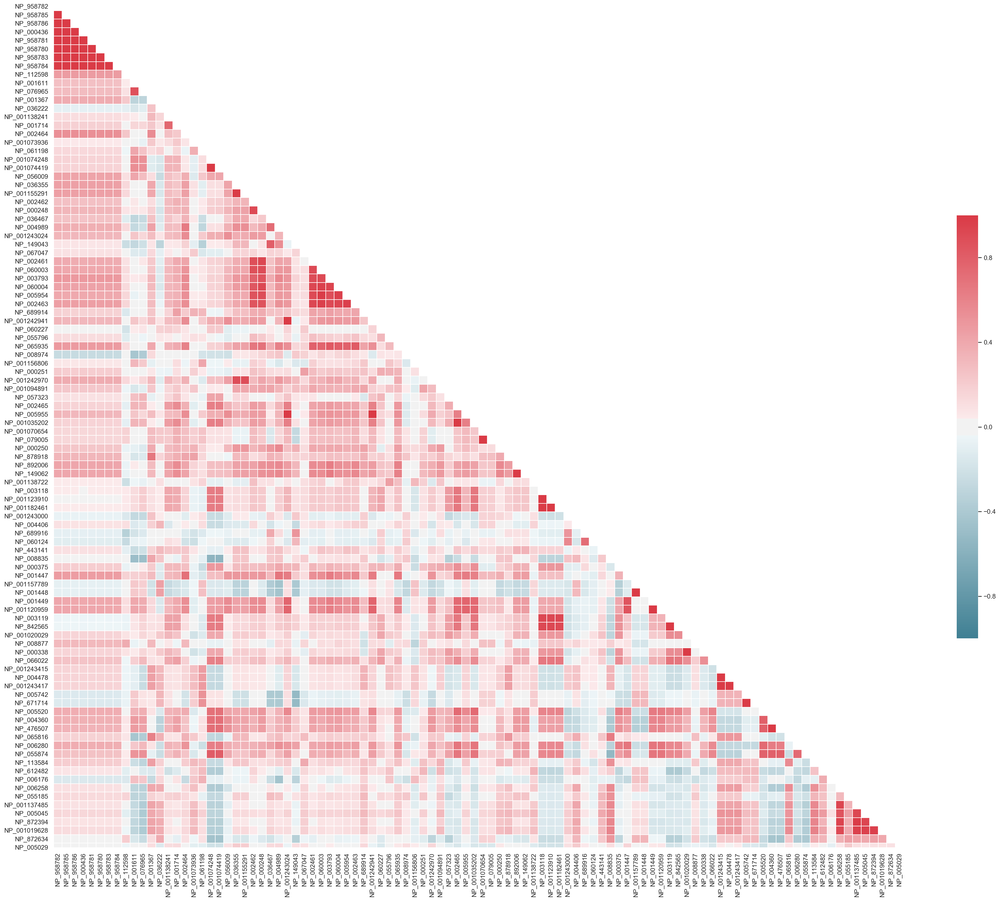

In [622]:
# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(correl, dtype=np.bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(33, 27))

# Generate a custom colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(correl, mask=mask, cmap=cmap, vmax=1, vmin=-1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})


We can observe that we´ve got quite a few clusters of really strong correlations (most red ones) near the diagonal edge but also small ones every two three proteins. This tells us that is not individual interactions only but little groups that behave similarly. 

Also noteworthy the fact of having lesser quantity of negative correlations (blue), which could be something worht the analysis as this could be a strong pattern to look for when identifying new patterns.

Now we prepare the correlation matrix to be represented by NetworkX. Performs better in arrays, not DF.

### Correlation Representation. 

Our aim with the Correlation Matrix is to use it as a Weighted Network to understand how the proteins behave amongst themselves. 

In [584]:
proteins = correl.index.values
correl_matrix = np.asmatrix(correl)

In [586]:
# Loading the graph from numpy Matrix
G = nx.from_numpy_matrix(correl_matrix)

# Assigning the Protein Names
G = nx.relabel_nodes(G,lambda x: proteins[x])

In [623]:
def plotCorrGraph(graph):    
    edges,weights = zip(*nx.get_edge_attributes(graph,'weight').items())
    
    #positions
    positions=nx.circular_layout(graph)
    
    #Figure size
    plt.figure(figsize=(33,27))

    #draws nodes
    nx.draw_networkx_nodes(graph,positions,node_color='#DA70D6',
                           node_size=500,alpha=0.8)
    
    #Styling for labels
    nx.draw_networkx_labels(graph, positions, font_size=8, 
                            font_family='sans-serif')
        
    #draws the edges
    nx.draw_networkx_edges(graph, positions, edge_list=edges,style='solid')

    
    # displays the graph without axis
    plt.axis('off')
    #saves image
    plt.savefig("graph.png", format="PNG")
    plt.show() 

### 1. Full Correlation Matrix Network

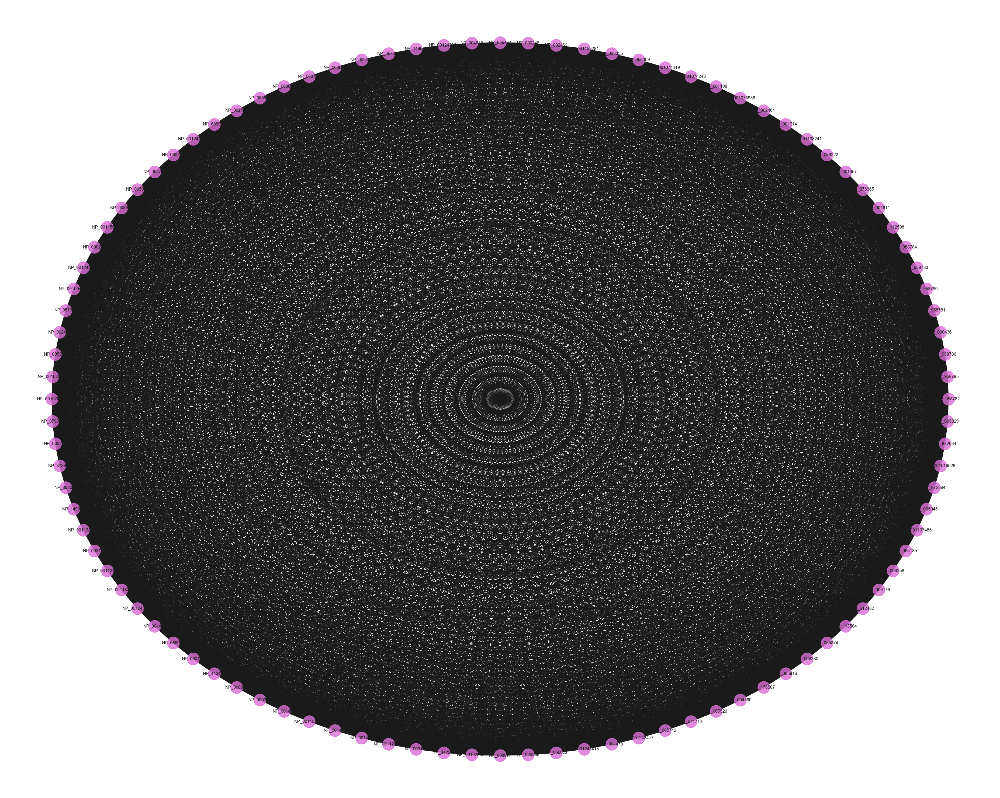

In [624]:
# Plotting the whole correlation matrix
plotCorrGraph(G)

In [627]:
# Densidad
nx.density(G)

1.02020202020202

As we can see, we do have too many nodes intertwined with eachother. Little information can be extracted from the graph.

### 2. Correlation Matrix splitted by positive and negative correlations.

In [630]:
def create_corr_network(G, mode):

    H = G.copy()

    # Checks all the edges and removes some based on mode
    for stock1, stock2, weight in list(H.edges(data=True)):
            if mode == "positive":
                if weight["weight"] <0:
                    H.remove_edge(stock1, stock2)
            else:
                if weight["weight"] >=0:
                    H.remove_edge(stock1, stock2)
                    
    print(nx.density(H))
                    
    # Function previously defined to plot
    plotCorrGraph(H)

0.738989898989899


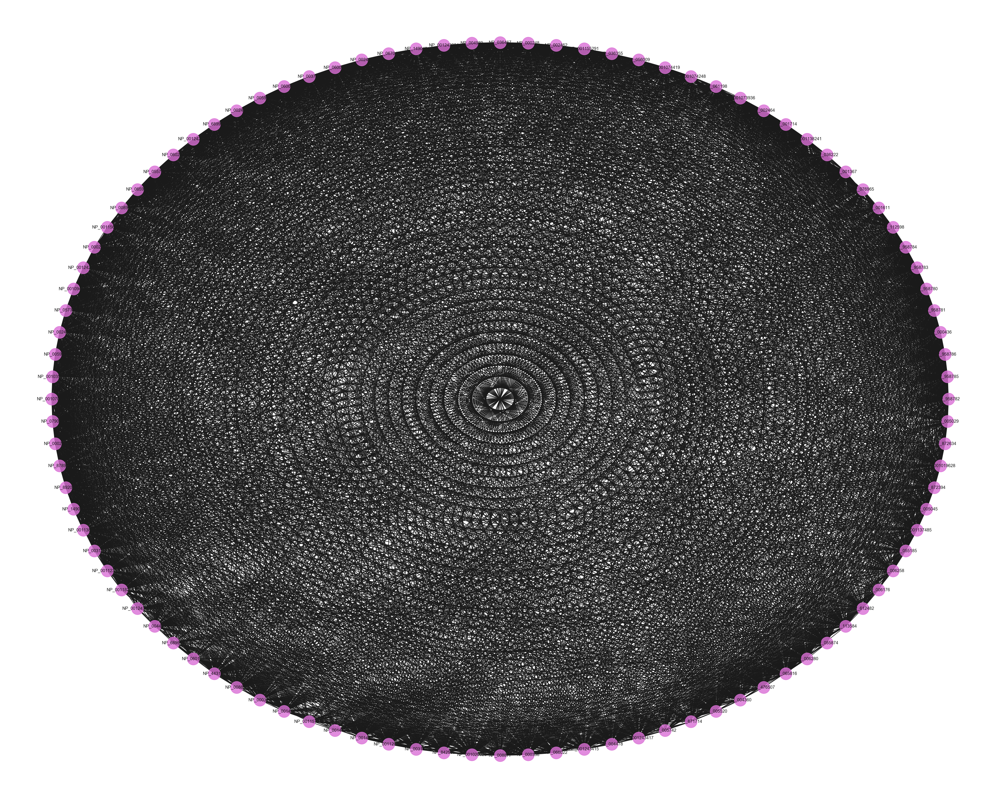

In [631]:
create_corr_network(G,'positive')

0.2812121212121212


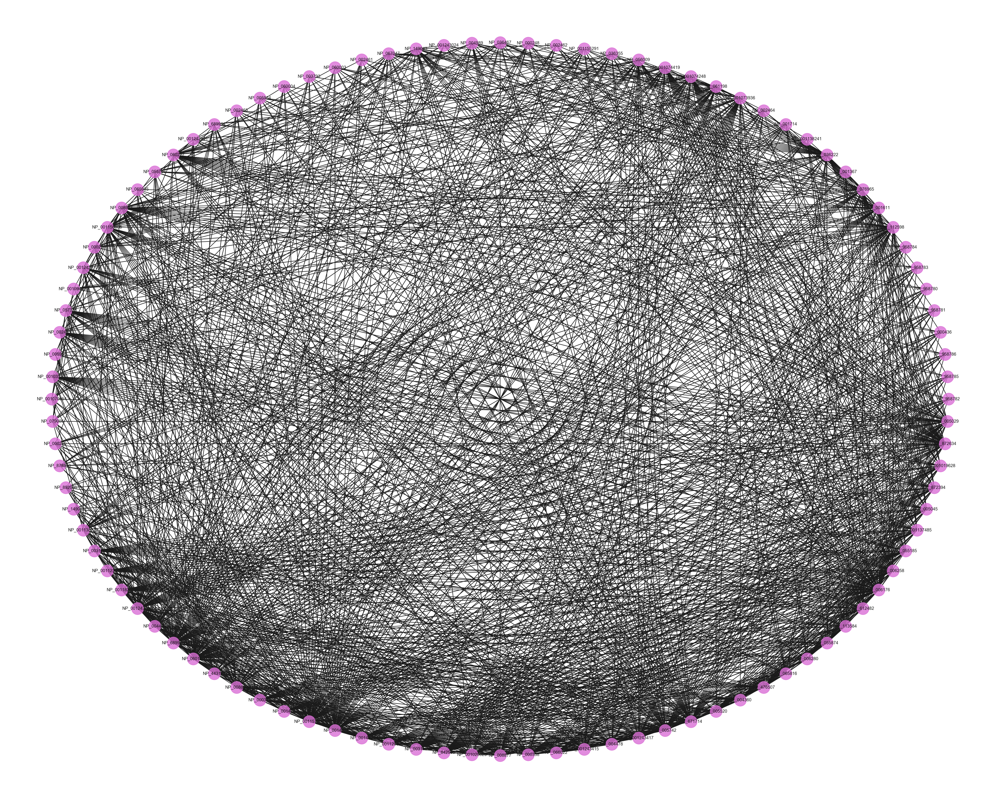

In [632]:
create_corr_network(G,'negative')

We can now see that the pattern has changed. Now it is not as dense as before. The negative correlation graph now is a bit more legible though not fully useful yet.

### 2.3 Correlation Network filtered

Let´s now filter out some of the correlations to really observe the ones which could establish a more defined pattern on the behavioural study. To do so, we will generate another function that filters out taking a threshold and also that plots in a different way depending on the weights.

In [611]:
def create_corr_network_filtered_scaled(G, mode, f):

    H = G.copy()

    # Checks all the edges and removes some based on mode
    for protein_1, protein_2, weight in list(H.edges(data=True)):
            if mode == "positive":
                if(weight["weight"] <0 or weight["weight"] <= f):
                    H.remove_edge(protein_1, protein_2)
            else:
                if(weight["weight"] >=0 or weight["weight"] >= f):
                    H.remove_edge(protein_1, protein_2)

    
    # creates a list for edges and for the weights
    edges,weights = zip(*nx.get_edge_attributes(H,'weight').items())
    
    # increases the value of weights, so that they are more visible in the graph
    weights_n = tuple([(1+abs(x))**2 for x in weights])
    
    # calculates the degree of each node
    deg = nx.degree(H)
    
    # creates list of nodes and a list their degrees that will be used later for their sizes
    nodelist = [n for n, d in deg]
    node_sizes = [d for n, d in deg]

    #positions
    positions=nx.circular_layout(H)
    
    #Figure size
    plt.figure(figsize=(15,15))


    # edge and nodes colors based on mode
    if mode == "positive":
        edge_colour = plt.cm.GnBu 
        node_color='#b1edff'
    else:
        edge_colour = plt.cm.YlOrRd
        node_color='#F9D3D3'
        
    # draws nodes
    nx.draw_networkx_nodes(H,positions,node_color=node_color,nodelist=nodelist,
                           node_size=tuple([x**3 for x in node_sizes]),alpha=0.8)
    
    # Styling for labels
    nx.draw_networkx_labels(H, positions, font_size=8, 
                            font_family='sans-serif')
    # Draws the edges
    nx.draw_networkx_edges(H, positions, edge_list=edges,style='solid',
                          width=weights_n, edge_color = weights_n, edge_cmap = edge_colour,
                          edge_vmin = min(weights_n), edge_vmax=max(weights_n))

    # displays the graph without axis
    plt.axis('off')
    
    # saves image
    plt.savefig("filtered_" + mode + ".png", format="PNG")
    plt.show() 
    

In [612]:
def getSortedWeights(graph,mode):
    
    # Returns a readable list of information about the nodes and weight
    if mode=='positive':
        return [(a, b, data) for (a, b, data) in sorted(graph.edges(data=True),reverse=True , key=lambda x: x[2]['weight']) if data['weight'] >= 0 and data['weight'] < 1]
    else:
        return [(a, b, data) for (a, b, data) in sorted(graph.edges(data=True), key=lambda x: x[2]['weight']) if data['weight'] < 0]

Let´s get as well the complete weights list splitted by negative and positive correlations to analyse the distribution and also to choose our threshold. 

In [615]:
weights_neg = [edge[2]['weight'] for edge in list(G.edges(data=True)) if edge[2]['weight'] < 0]
weights_pos = [edge[2]['weight'] for edge in list(G.edges(data=True)) if edge[2]['weight'] >= 0]

Text(0.5, 0, 'negative weights')

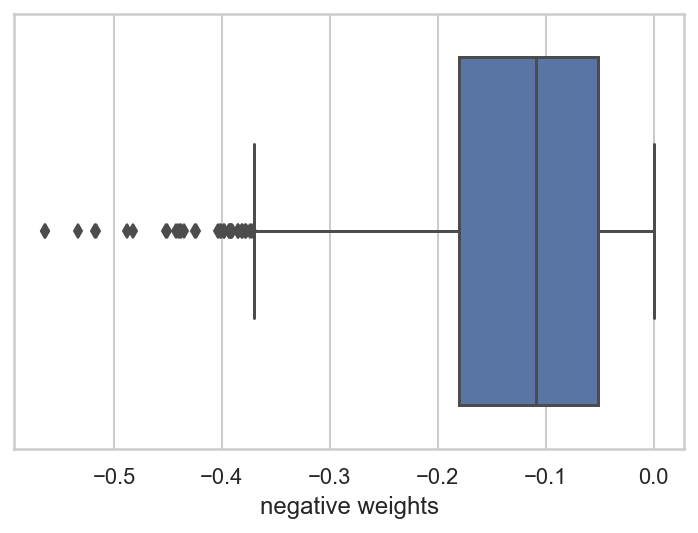

In [639]:
sns.set(style="whitegrid")
bx = sns.boxplot(weights_neg)
bx.set_xlabel("negative weights")


Most of the negative correlation values are between $[-0.05, -0.18]$. As we are looking for outliers, $-0.2$ could be a good start.

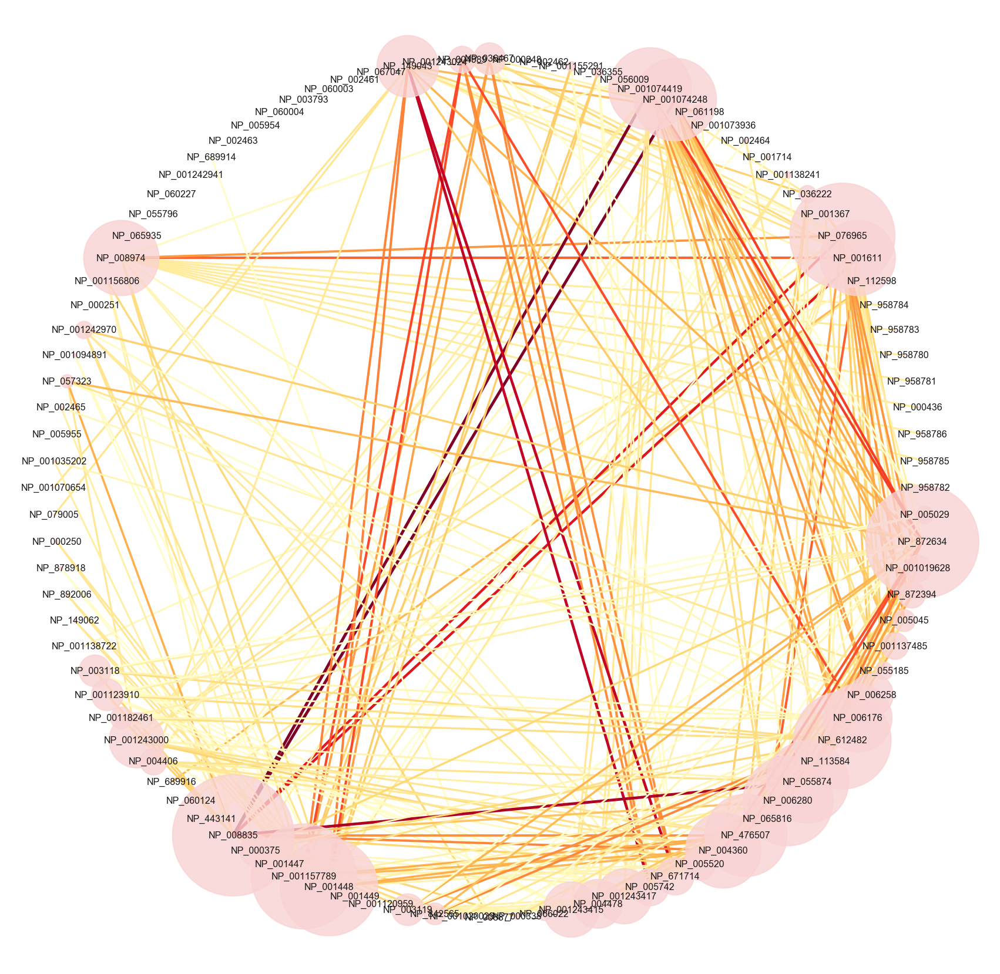

In [617]:
create_corr_network_filtered_scaled(G, 'negative', -0.2)

We can now observe better the relations between proteins and the ones most connected among the outliers.

In [605]:
getSortedWeights(G, 'negative')[:30]

[('NP_001074419', 'NP_008835', {'weight': -0.5640240846761658}),
 ('NP_001074248', 'NP_008835', {'weight': -0.5638700605751045}),
 ('NP_008835', 'NP_055874', {'weight': -0.5330230577050538}),
 ('NP_149043', 'NP_005742', {'weight': -0.5176279769972072}),
 ('NP_149043', 'NP_671714', {'weight': -0.5169977792957303}),
 ('NP_001611', 'NP_008835', {'weight': -0.48766522302276816}),
 ('NP_076965', 'NP_008835', {'weight': -0.48261997840244525}),
 ('NP_001074248', 'NP_872634', {'weight': -0.45130996878555857}),
 ('NP_001074419', 'NP_872634', {'weight': -0.45100551768277136}),
 ('NP_004989', 'NP_001157789', {'weight': -0.4421000986652433}),
 ('NP_004989', 'NP_001448', {'weight': -0.44108414255466954}),
 ('NP_004989', 'NP_006176', {'weight': -0.4388319195937233}),
 ('NP_476507', 'NP_872634', {'weight': -0.43815651447980164}),
 ('NP_004360', 'NP_872634', {'weight': -0.43471724244345655}),
 ('NP_001611', 'NP_065816', {'weight': -0.42512053033673697}),
 ('NP_001611', 'NP_008974', {'weight': -0.42441

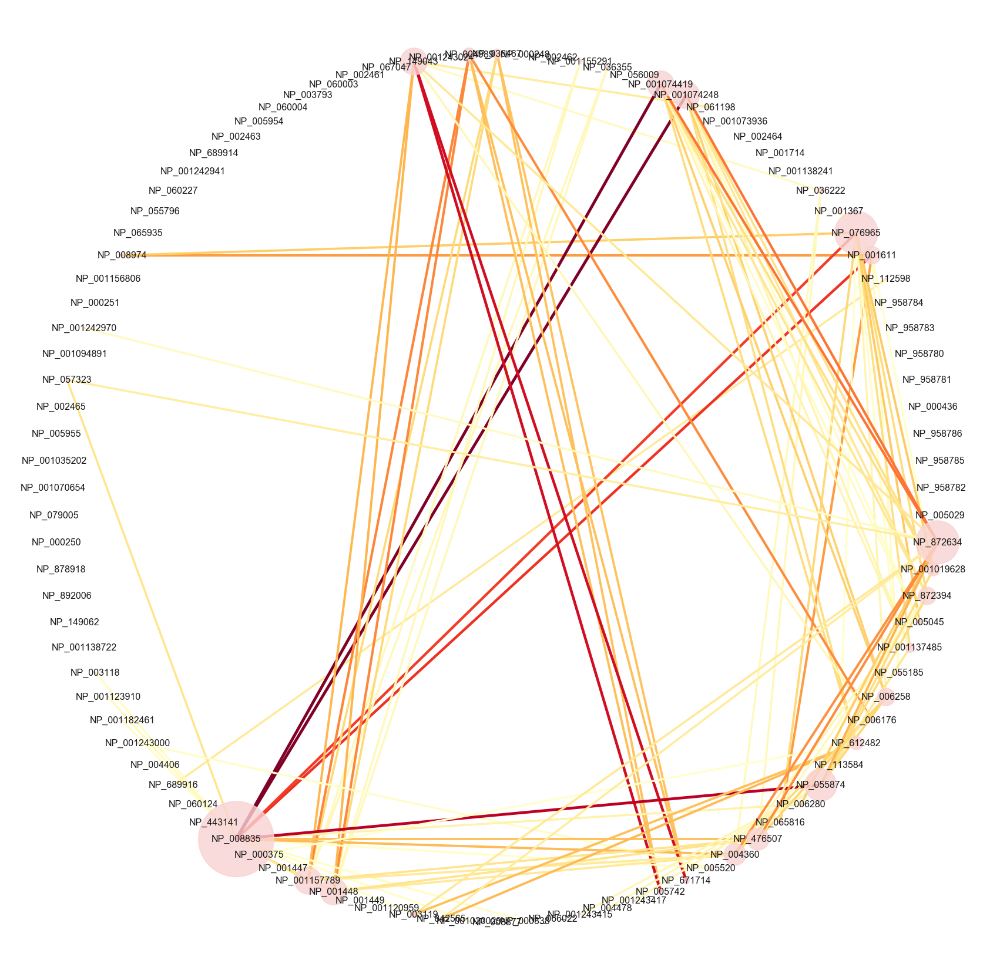

In [618]:
create_corr_network_filtered_scaled(G, 'negative', -0.3)

Text(0.5, 0, 'positive weights')

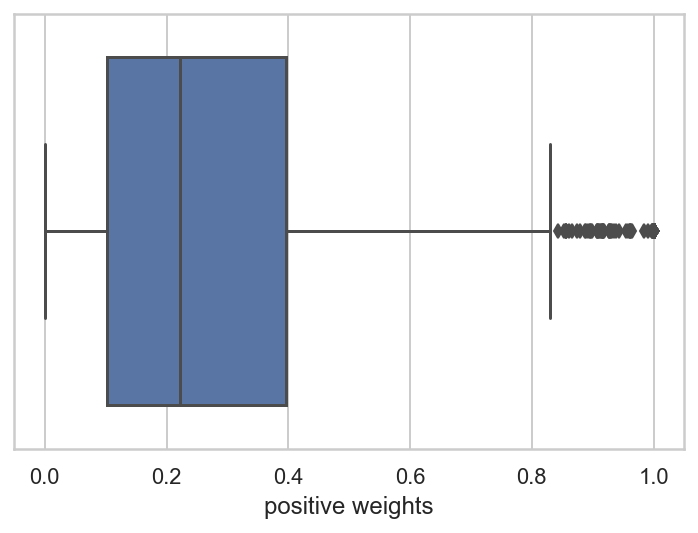

In [607]:
sns.set(style="whitegrid")
bx = sns.boxplot(weights_pos)
bx.set_xlabel("positive weights")

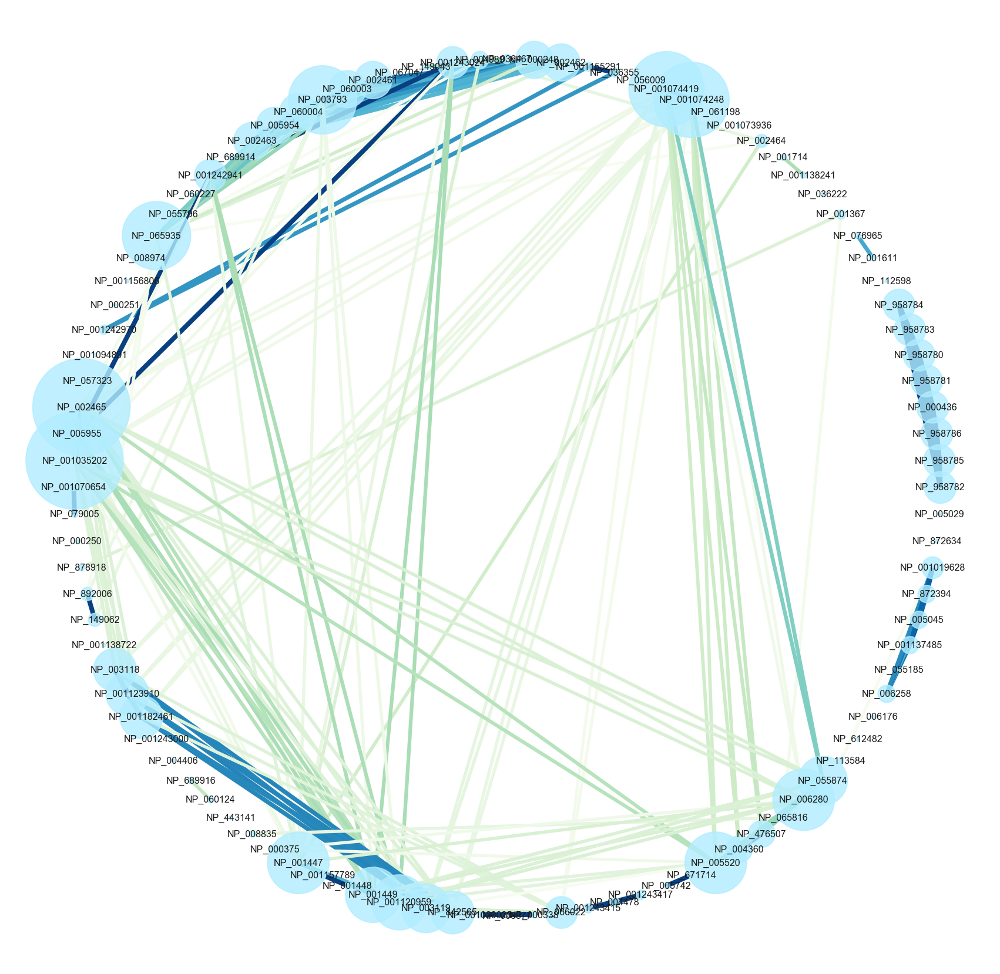

In [608]:
create_corr_network_filtered_scaled(G, 'positive', 0.6)

In [640]:
getSortedWeights(G, 'positive')[:30]

[('NP_958783', 'NP_958784', {'weight': 0.9999998694395967}),
 ('NP_001020029', 'NP_000338', {'weight': 0.9999957337987387}),
 ('NP_958780', 'NP_958783', {'weight': 0.9999945226022914}),
 ('NP_958780', 'NP_958784', {'weight': 0.9999943468035107}),
 ('NP_958785', 'NP_958786', {'weight': 0.9999938463543888}),
 ('NP_958785', 'NP_958783', {'weight': 0.9999931608368895}),
 ('NP_958785', 'NP_958784', {'weight': 0.9999930805069036}),
 ('NP_958786', 'NP_958783', {'weight': 0.9999930714173731}),
 ('NP_958786', 'NP_958784', {'weight': 0.999992959172113}),
 ('NP_958785', 'NP_958780', {'weight': 0.9999920985136925}),
 ('NP_958786', 'NP_958780', {'weight': 0.9999913865805906}),
 ('NP_958781', 'NP_958780', {'weight': 0.9999831241547252}),
 ('NP_958781', 'NP_958784', {'weight': 0.9999830344441141}),
 ('NP_958781', 'NP_958783', {'weight': 0.9999826225880535}),
 ('NP_958786', 'NP_958781', {'weight': 0.9999794263090945}),
 ('NP_958785', 'NP_958781', {'weight': 0.9999792037905619}),
 ('NP_001157789', 'NP_

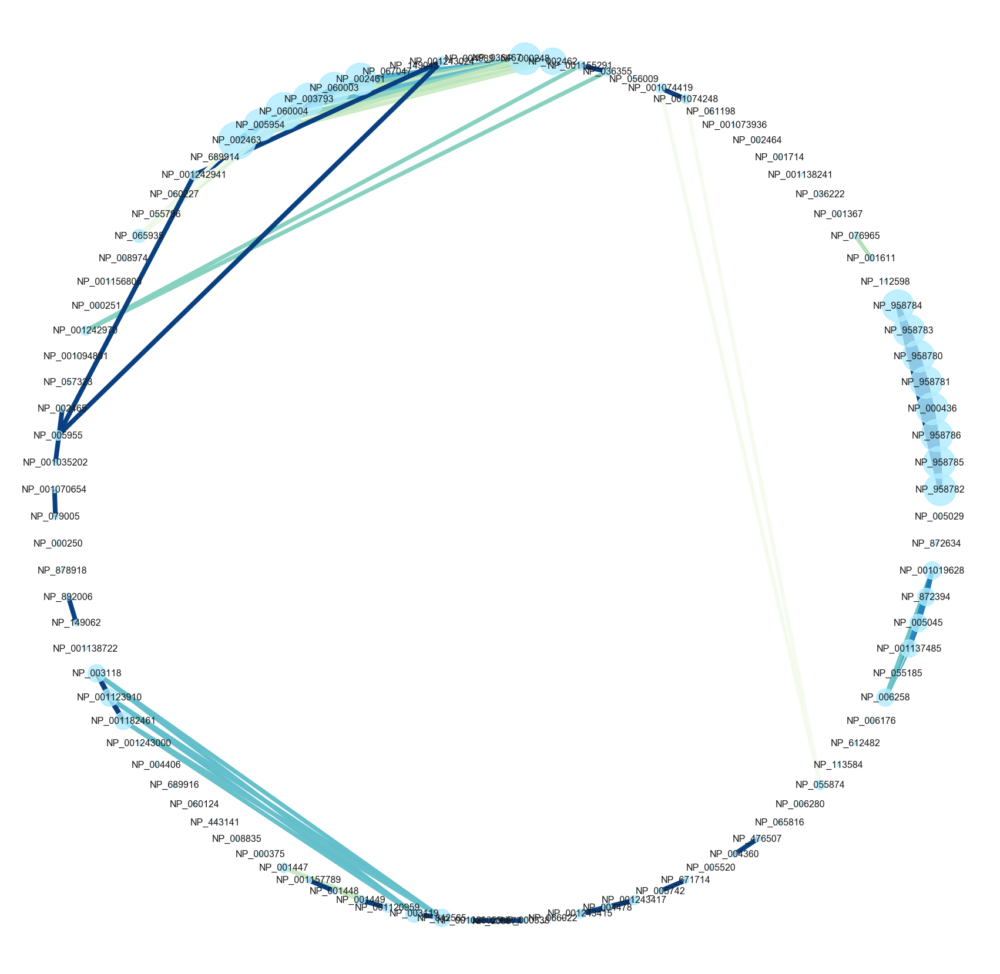

In [610]:
create_corr_network_filtered_scaled(G, 'positive', 0.8)